In [1]:
import math
import sys
import os
sys.path.insert(0,'..')
from doe_xstock.data import CityLearnData
import matplotlib.pyplot as plt
%matplotlib inline
import pandas as pd
import seaborn as sns
from src.utilities import DataHandler, FileHandler
import json

### Previous Notes/Questions

In [9]:
##Question: What is indoor_bulb_temperature_without_partial_load?
#is the building temperature if there were no heat pump control. 
#the temperature that would correlate with ideal load so it equals 
#the temperature time series in the building files.

In [10]:
##Question: Are occupant-thermostat interaction models being triggered ever? 
equal_rows_count = (data['indoor_dry_bulb_temperature_set_point'] == data['indoor_dry_bulb_temperature_set_point_without_control']).sum()

print("Number of rows where the two columns are equal:", equal_rows_count)

Number of rows where the two columns are equal: 139


In [27]:
##Answer: The occupant-thermostat interaction models are being triggered and the setpoint changes.

In [2]:
#Giuseppe's work: When UNOCCUPIED: override controller action and set Q_cool to zero
#Disadvantage: The controller does not learn the occupancy and that there is flexibility when unoccupied since the occupancy 
#effect is implicit
#In our work, we want to integrate this into the reward function
#AKA IF OCCUPIED: reward = electricity consumption + discomfort 
#IF UNOCCUPIED: reward = electricity consumption ##Can play around with exponents as well for this
#Problem: Our ResStock models still appear to have very little unoccupied periods...

In [31]:
##To do: Try to run simulation for really low SPs as an example (e.g. 15 degrees C)
##to make sure that the interaction models are triggered for each Occupant Type

### Sanity Check: SP = 15 C - LOD 3

In [18]:
os.getcwd()

'/root/CityLearn/simulation/notebooks'

In [27]:
data = pd.concat(
    [DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_1-final-2022_15SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_2-final-2022_15SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_3-final-2022_15SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_4-final-2022_15SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_5-final-2022_15SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_6-final-2022_15SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_7-final-2022_15SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_8-final-2022_15SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_9-final-2022_15SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_10-final-2022_15SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_1-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_2-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_3-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_4-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_5-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_6-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_7-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_8-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_9-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_10-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_1-citylearn-rbc-norbc-centralized-noreward-building_all-final-2022', 'time_series')],
    ignore_index=True)

In [28]:
unique_values_in_order = data['bldg_name'].unique().tolist()

In [29]:
buildings = unique_values_in_order
data = data[data['bldg_name'].isin(buildings)].copy()
data['lod'] = data['id'].str.split('-', expand=True)[0]

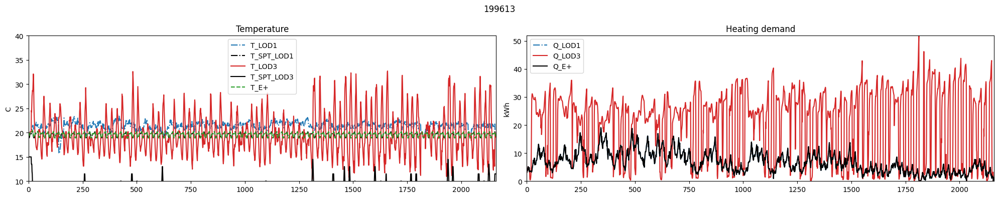

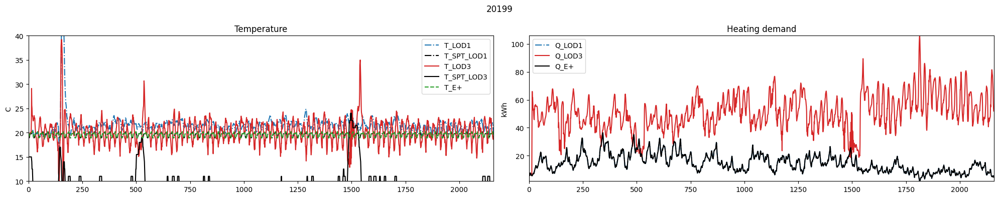

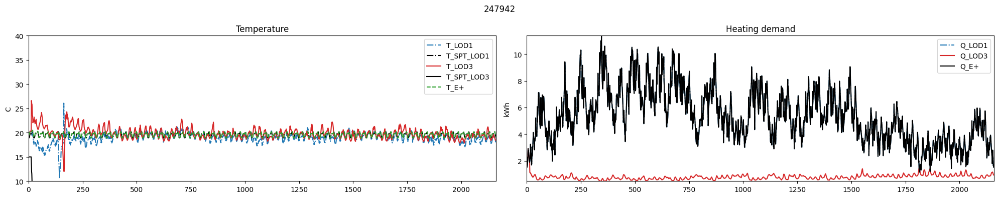

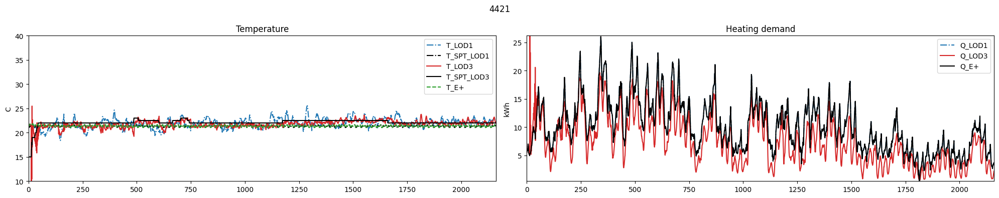

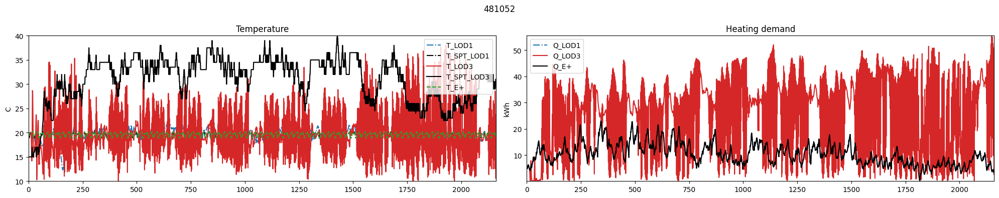

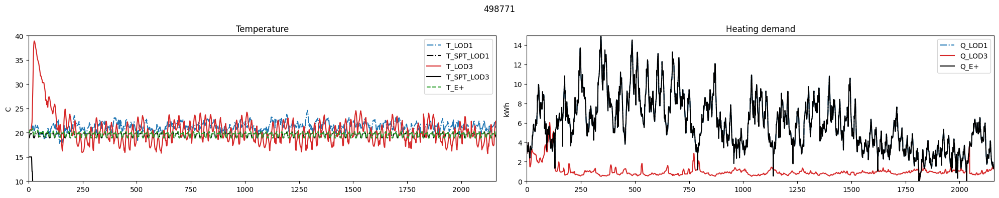

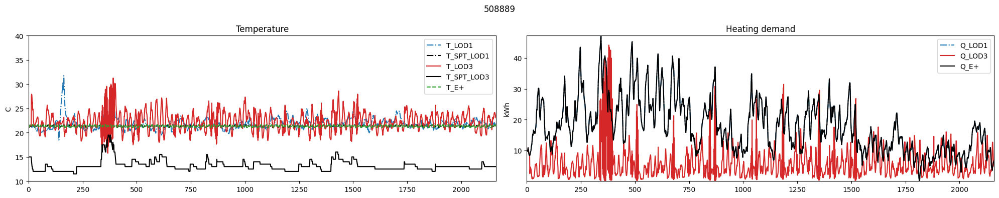

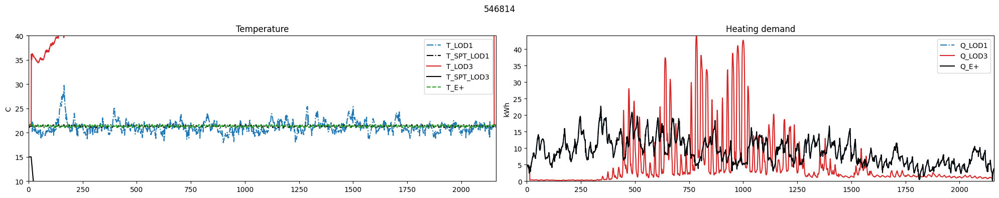

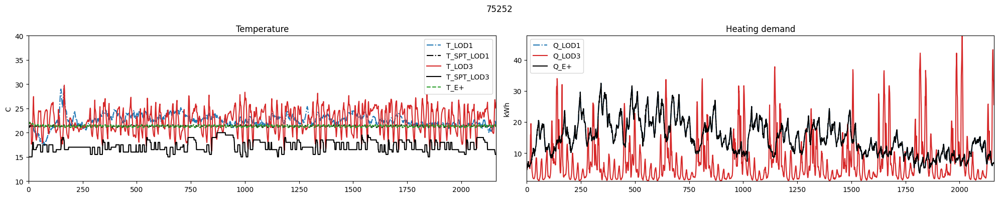

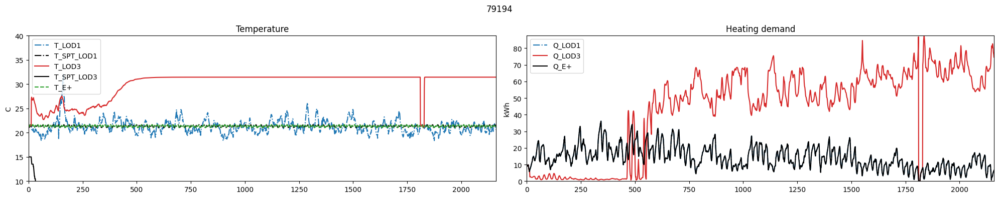

In [22]:
for b, bdata in data.groupby('bldg_name'):
    fig, axs = plt.subplots(1, 2, figsize=(20, 4))
    lod1data = bdata[bdata['lod']=='lod_1'].copy()
    lod3data = bdata[bdata['lod']=='lod_3'].copy()
    x = lod1data['time_step'].tolist()

    # temperature
    y1 = lod1data['indoor_dry_bulb_temperature'].tolist()
    y2 = lod1data['indoor_dry_bulb_temperature_set_point'].tolist()
    y3 = lod3data['indoor_dry_bulb_temperature'].tolist()
    y4 = lod3data['indoor_dry_bulb_temperature_set_point'].tolist()
    y5 = lod3data['indoor_dry_bulb_temperature_without_partial_load'].tolist()
    fig.axes[0].plot(x, y1, label='T_LOD1', color='tab:blue', linestyle='-.')
    fig.axes[0].plot(x, y2, label='T_SPT_LOD1', color='black', linestyle='-.')
    fig.axes[0].plot(x, y3, label='T_LOD3', color='tab:red', linestyle='-')
    fig.axes[0].plot(x, y4, label='T_SPT_LOD3', color='black', linestyle='-')
    fig.axes[0].plot(x, y5, label='T_E+', color='tab:green', linestyle='--')
    fig.axes[0].set_title('Temperature')
    fig.axes[0].set_ylim(10,40)
    fig.axes[0].set_ylabel('C')
    fig.axes[0].margins(0)
    fig.axes[0].legend()
    

    # demand
    y1 = lod1data['heating_demand'].tolist()
    y2 = lod3data['heating_demand'].tolist()
    y3 = lod3data['heating_demand_without_partial_load'].tolist()
    fig.axes[1].plot(x, y1, label='Q_LOD1', color='tab:blue', linestyle='-.')
    fig.axes[1].plot(x, y2, label='Q_LOD3', color='tab:red', linestyle='-')
    fig.axes[1].plot(x, y3, label='Q_E+', color='black', linestyle='-')
    fig.axes[1].set_title('Heating demand')
    fig.axes[1].set_ylabel('kWh')
    fig.axes[1].margins(0)
    fig.axes[1].legend()

    fig.suptitle(b)
    plt.tight_layout()
    plt.show()

In [23]:
data.iloc[2174,:]

bldg_name                                                                                                          20199
net_electricity_consumption                                                                                    31.554701
net_electricity_consumption_without_storage                                                                    31.554701
net_electricity_consumption_without_storage_and_partial_load                                                    6.772785
net_electricity_consumption_without_storage_and_partial_load_and_pv                                             6.772785
indoor_dry_bulb_temperature                                                                                    29.113087
indoor_dry_bulb_temperature_without_partial_load                                                               19.923748
indoor_dry_bulb_temperature_set_point                                                                               14.5
indoor_dry_bulb_temperature_set_

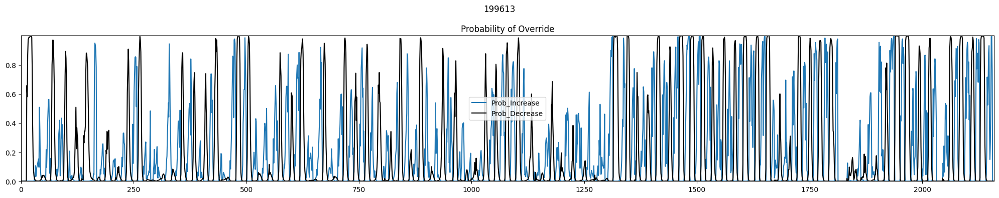

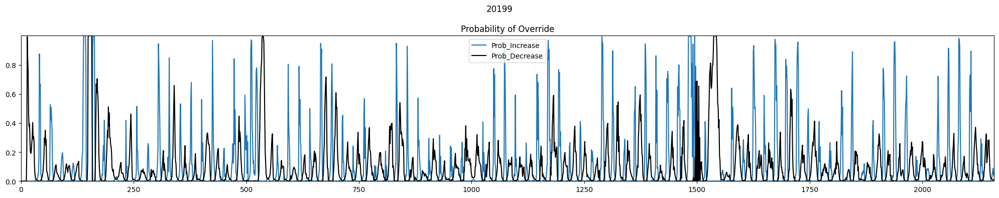

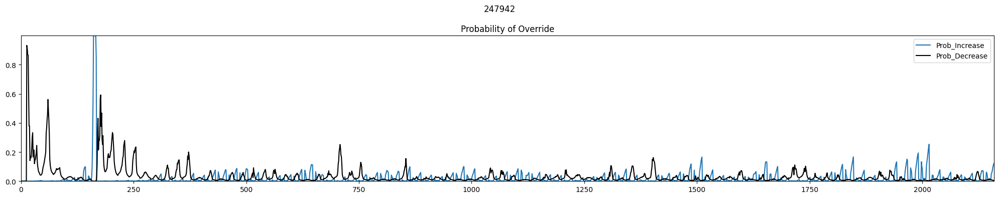

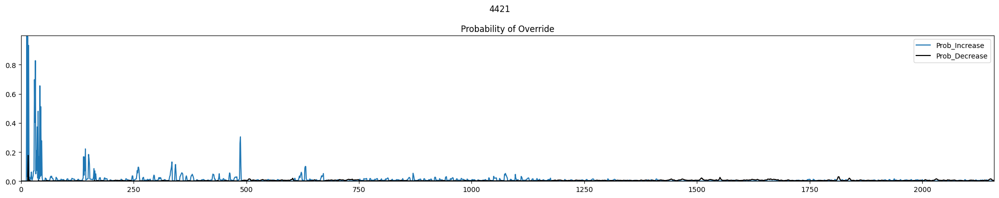

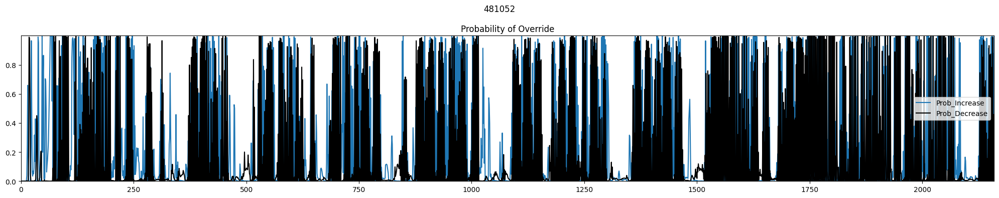

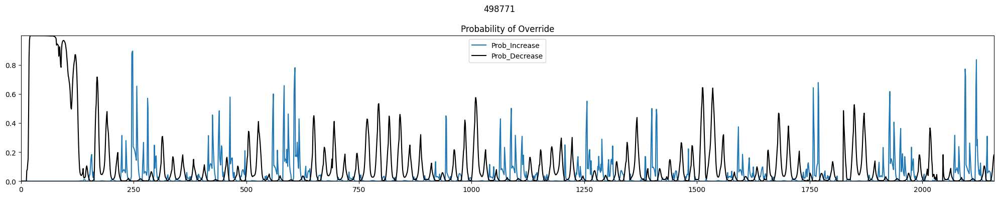

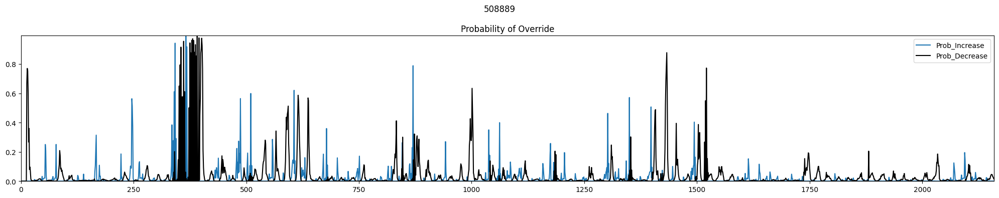

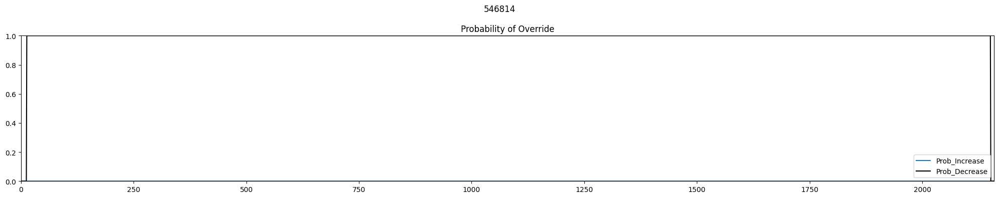

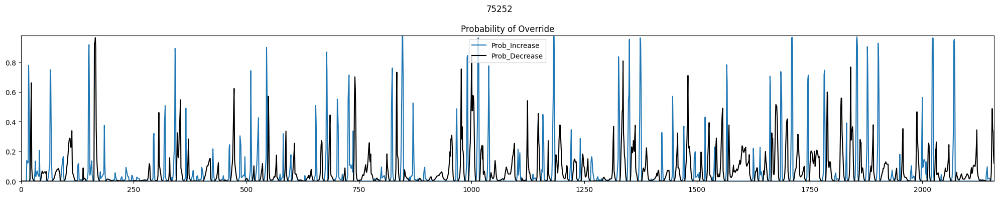

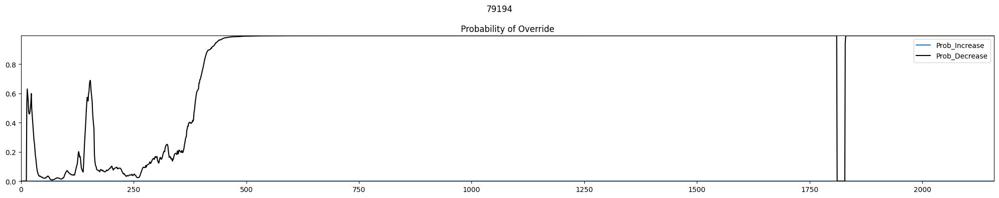

In [30]:
for b, bdata in data.groupby('bldg_name'):
    fig, axs = plt.subplots(1, figsize=(20, 4))
    lod3data = bdata[bdata['lod']=='lod_3'].copy()
    x = lod3data['time_step'].tolist()

    # temperature
    y1 = lod3data['occupant_increase_setpoint_probability'].tolist()
    y2 = lod3data['occupant_decrease_setpoint_probability'].tolist()
    fig.axes[0].plot(x, y1, label='Prob_Increase', color='tab:blue') #linestyle='-.')
    fig.axes[0].plot(x, y2, label='Prob_Decrease', color='black') #linestyle='-.')

    fig.axes[0].set_title('Probability of Override')
    #fig.axes[0].set_ylim(10,40)
    #fig.axes[0].set_ylabel('C')
    fig.axes[0].margins(0)
    fig.axes[0].legend()

    fig.suptitle(b)
    plt.tight_layout()
    plt.show()

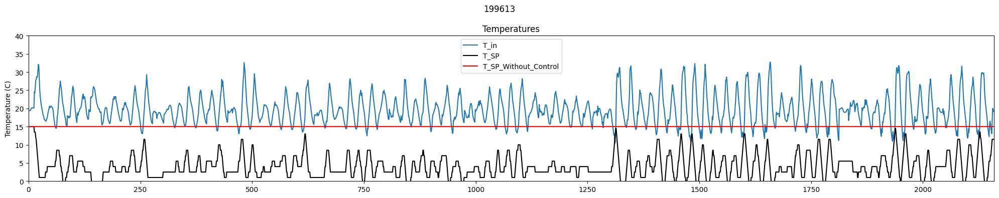

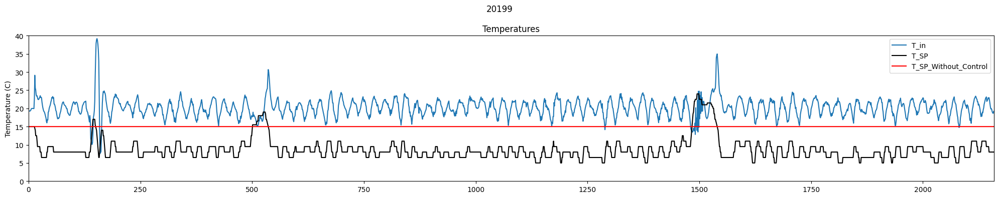

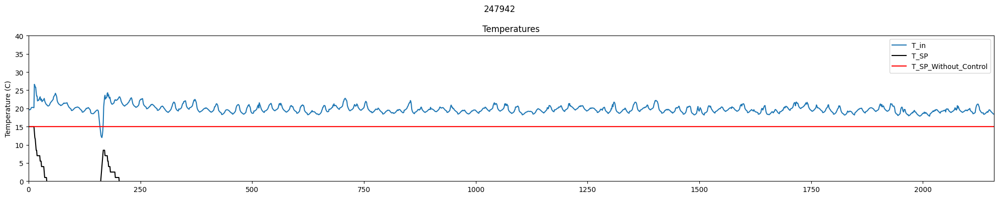

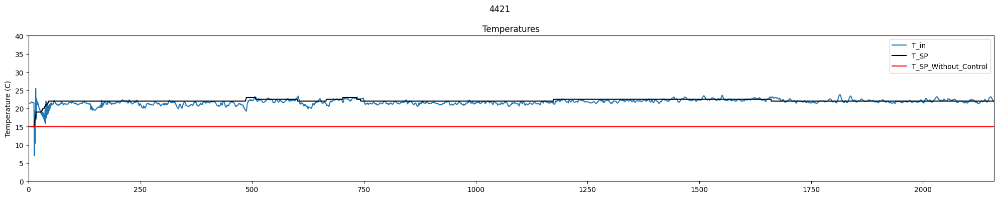

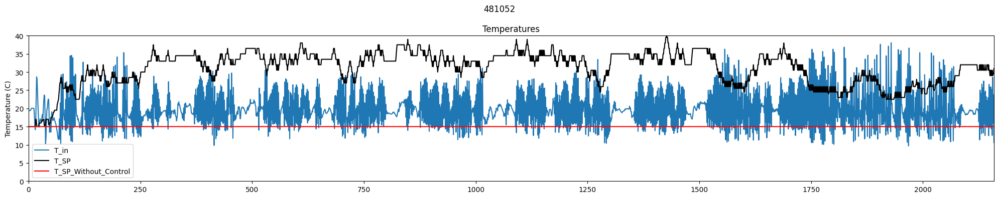

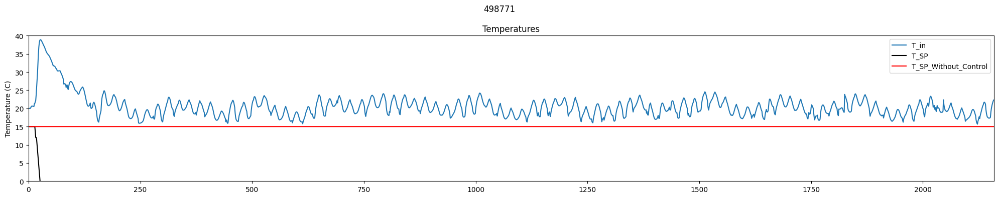

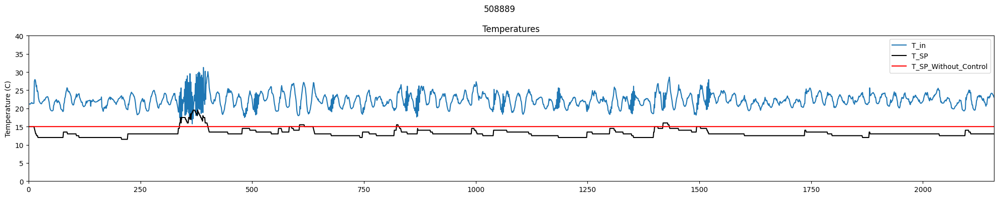

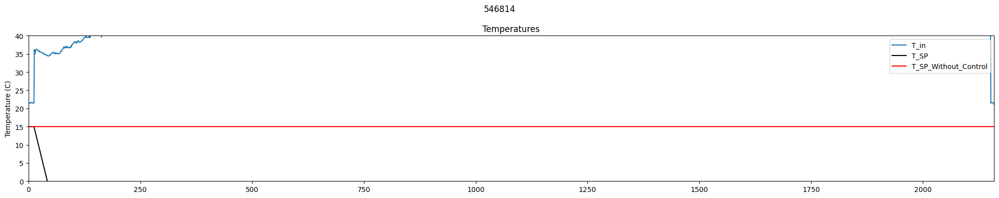

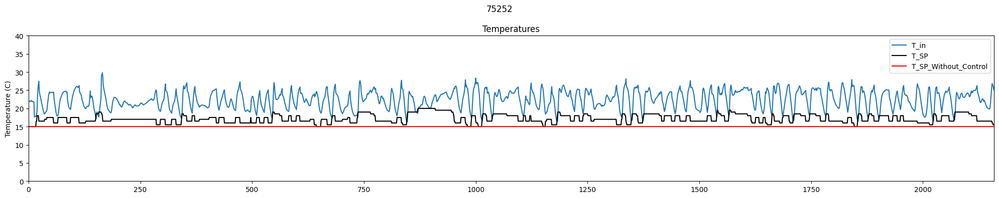

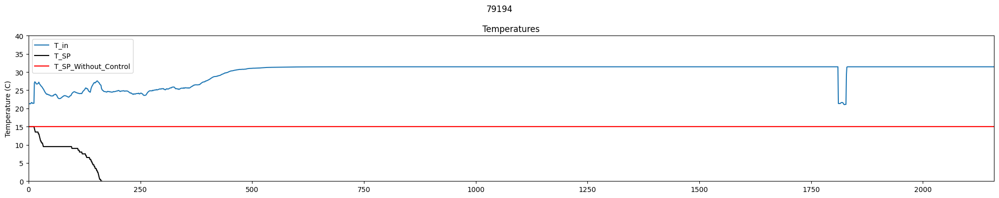

In [35]:
for b, bdata in data.groupby('bldg_name'):
    fig, axs = plt.subplots(1, figsize=(20, 4))
    lod3data = bdata[bdata['lod']=='lod_3'].copy()
    x = lod3data['time_step'].tolist()

    # temperature
    y1 = lod3data['indoor_dry_bulb_temperature'].tolist()
    y2 = lod3data['indoor_dry_bulb_temperature_set_point'].tolist()
    y3 = lod3data['indoor_dry_bulb_temperature_set_point_without_control'].tolist()
    fig.axes[0].plot(x, y1, label='T_in', color='tab:blue') #linestyle='-.')
    fig.axes[0].plot(x, y2, label='T_SP', color='black') #linestyle='-.')
    fig.axes[0].plot(x, y3, label='T_SP_Without_Control', color='red') #linestyle='-.')


    fig.axes[0].set_title('Temperatures')
    fig.axes[0].set_ylim(0,40)
    fig.axes[0].set_ylabel('Temperature (C)')
    fig.axes[0].margins(0)
    fig.axes[0].legend()

    fig.suptitle(b)
    plt.tight_layout()
    plt.show()

### TEST LSTM "ACCEPTABLE" BOUNDS: SP = 17 C - LOD 3

In [33]:
data_17 = pd.concat(
    [DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_1-final-2022_17SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_2-final-2022_17SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_3-final-2022_17SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_4-final-2022_17SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_5-final-2022_17SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_6-final-2022_17SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_7-final-2022_17SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_8-final-2022_17SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_9-final-2022_17SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_10-final-2022_17SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_1-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_2-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_3-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_4-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_5-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_6-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_7-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_8-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_9-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_10-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_1-citylearn-rbc-norbc-centralized-noreward-building_all-final-2022', 'time_series')],
    ignore_index=True)

unique_values_in_order_17 = data_17['bldg_name'].unique().tolist()

buildings_17 = unique_values_in_order_17
data_17 = data_17[data_17['bldg_name'].isin(buildings_17)].copy()
data_17['lod'] = data_17['id'].str.split('-', expand=True)[0]

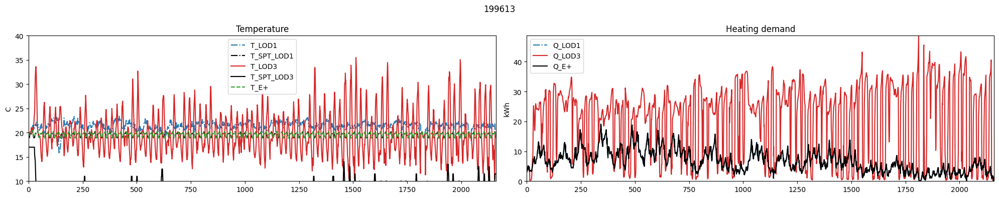

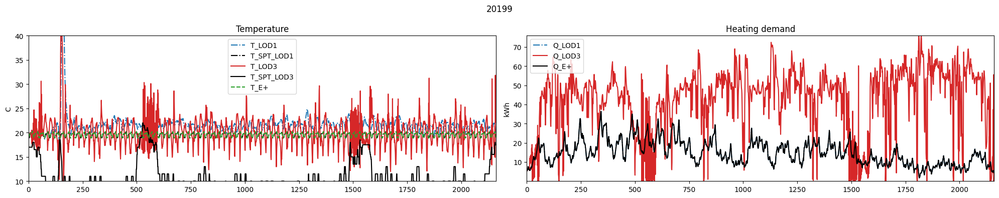

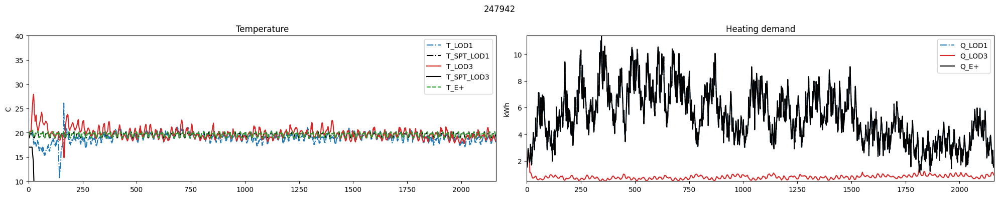

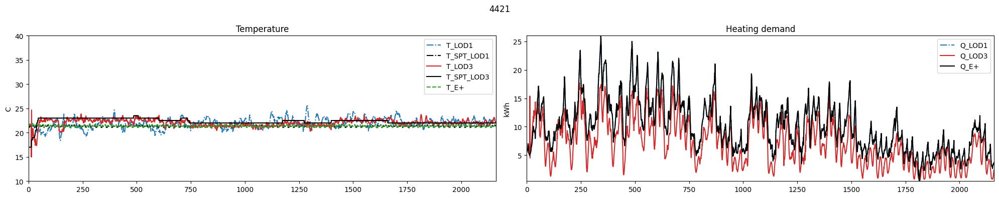

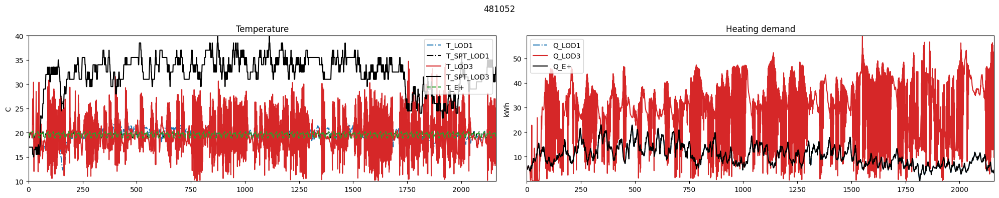

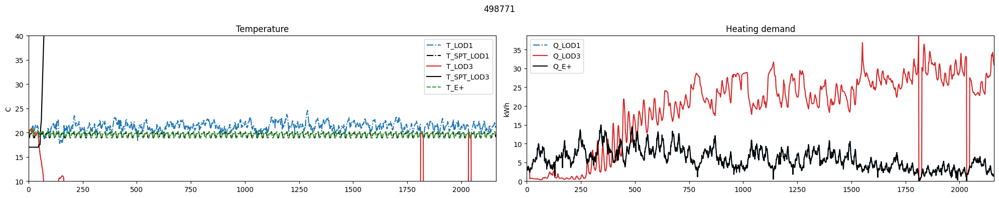

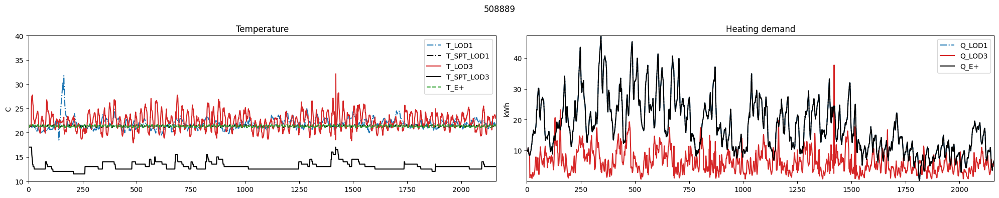

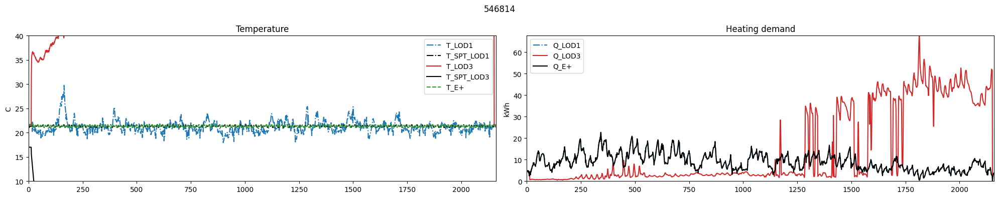

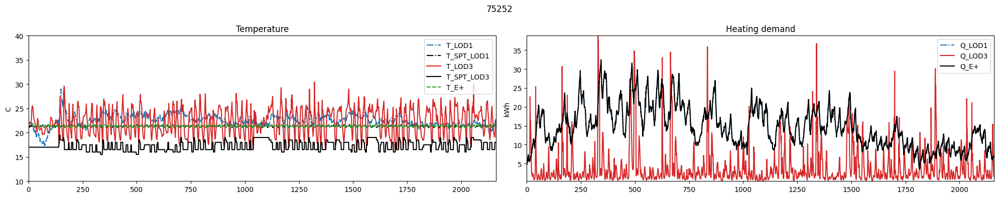

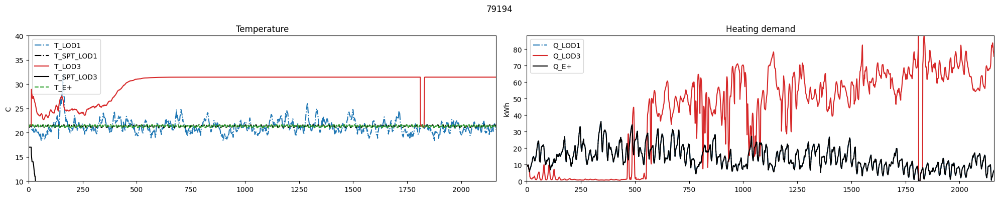

In [34]:
for b, bdata in data_17.groupby('bldg_name'):
    fig, axs = plt.subplots(1, 2, figsize=(20, 4))
    lod1data = bdata[bdata['lod']=='lod_1'].copy()
    lod3data = bdata[bdata['lod']=='lod_3'].copy()
    x = lod1data['time_step'].tolist()

    # temperature
    y1 = lod1data['indoor_dry_bulb_temperature'].tolist()
    y2 = lod1data['indoor_dry_bulb_temperature_set_point'].tolist()
    y3 = lod3data['indoor_dry_bulb_temperature'].tolist()
    y4 = lod3data['indoor_dry_bulb_temperature_set_point'].tolist()
    y5 = lod3data['indoor_dry_bulb_temperature_without_partial_load'].tolist()
    fig.axes[0].plot(x, y1, label='T_LOD1', color='tab:blue', linestyle='-.')
    fig.axes[0].plot(x, y2, label='T_SPT_LOD1', color='black', linestyle='-.')
    fig.axes[0].plot(x, y3, label='T_LOD3', color='tab:red', linestyle='-')
    fig.axes[0].plot(x, y4, label='T_SPT_LOD3', color='black', linestyle='-')
    fig.axes[0].plot(x, y5, label='T_E+', color='tab:green', linestyle='--')
    fig.axes[0].set_title('Temperature')
    fig.axes[0].set_ylim(10,40)
    fig.axes[0].set_ylabel('C')
    fig.axes[0].margins(0)
    fig.axes[0].legend()
    

    # demand
    y1 = lod1data['heating_demand'].tolist()
    y2 = lod3data['heating_demand'].tolist()
    y3 = lod3data['heating_demand_without_partial_load'].tolist()
    fig.axes[1].plot(x, y1, label='Q_LOD1', color='tab:blue', linestyle='-.')
    fig.axes[1].plot(x, y2, label='Q_LOD3', color='tab:red', linestyle='-')
    fig.axes[1].plot(x, y3, label='Q_E+', color='black', linestyle='-')
    fig.axes[1].set_title('Heating demand')
    fig.axes[1].set_ylabel('kWh')
    fig.axes[1].margins(0)
    fig.axes[1].legend()

    fig.suptitle(b)
    plt.tight_layout()
    plt.show()

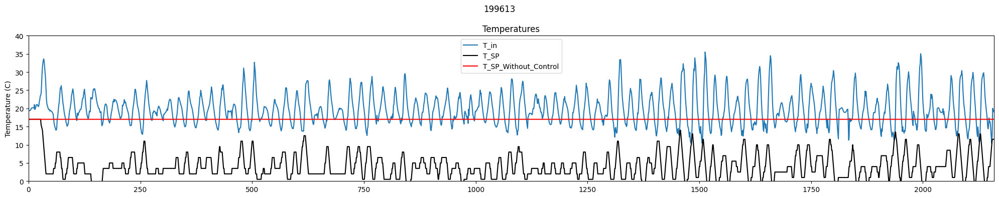

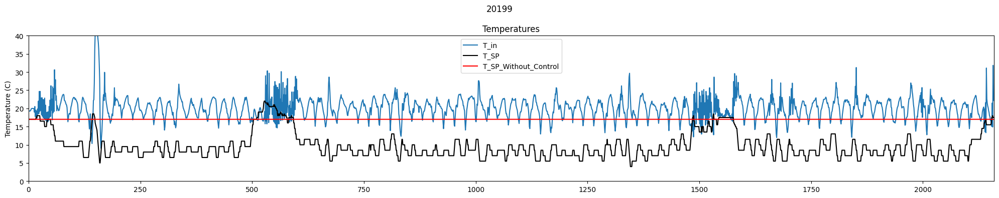

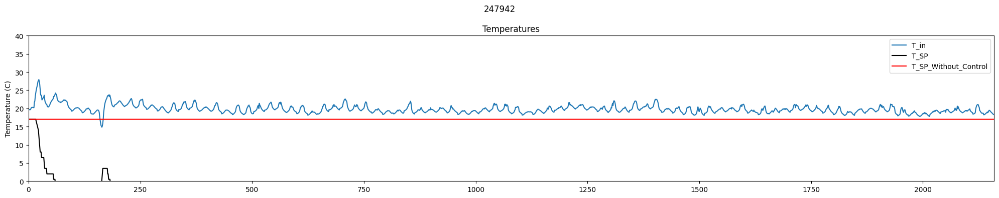

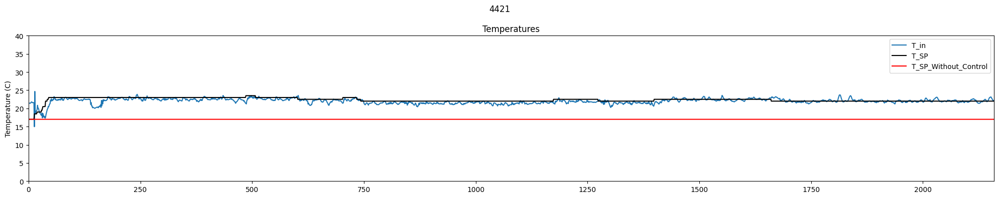

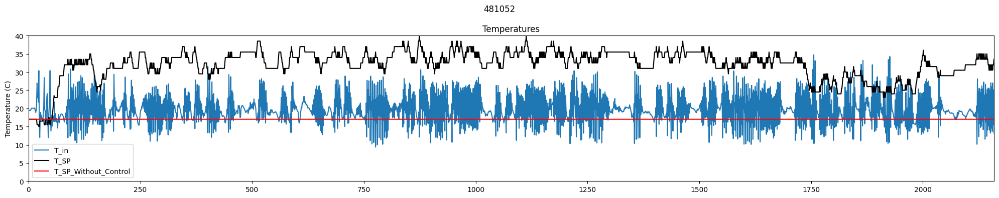

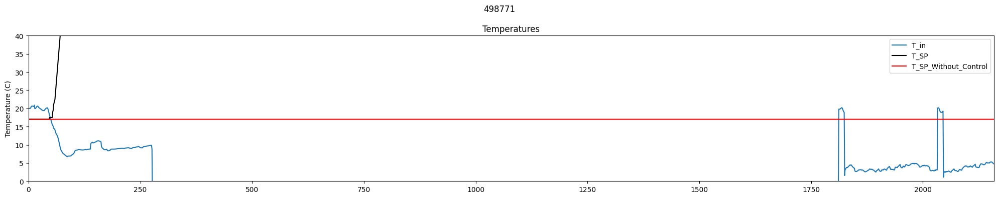

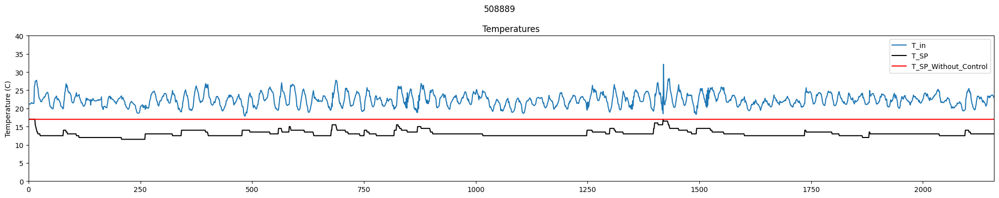

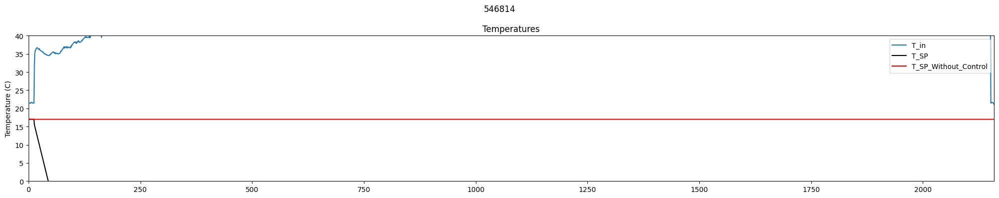

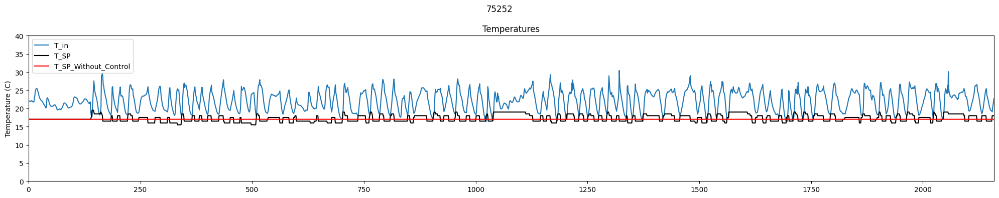

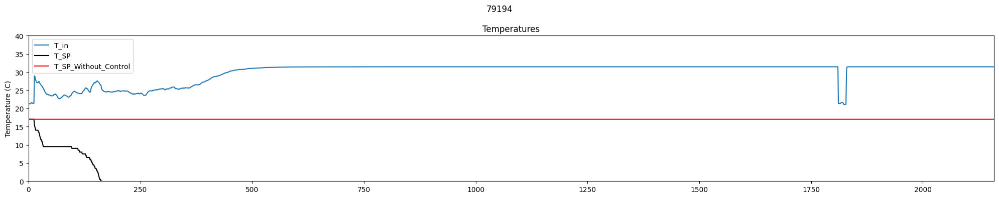

In [37]:
for b, bdata in data_17.groupby('bldg_name'):
    fig, axs = plt.subplots(1, figsize=(20, 4))
    lod3data = bdata[bdata['lod']=='lod_3'].copy()
    x = lod3data['time_step'].tolist()

    # temperature
    y1 = lod3data['indoor_dry_bulb_temperature'].tolist()
    y2 = lod3data['indoor_dry_bulb_temperature_set_point'].tolist()
    y3 = lod3data['indoor_dry_bulb_temperature_set_point_without_control'].tolist()
    fig.axes[0].plot(x, y1, label='T_in', color='tab:blue') #linestyle='-.')
    fig.axes[0].plot(x, y2, label='T_SP', color='black') #linestyle='-.')
    fig.axes[0].plot(x, y3, label='T_SP_Without_Control', color='red') #linestyle='-.')


    fig.axes[0].set_title('Temperatures')
    fig.axes[0].set_ylim(0,40)
    fig.axes[0].set_ylabel('Temperature (C)')
    fig.axes[0].margins(0)
    fig.axes[0].legend()

    fig.suptitle(b)
    plt.tight_layout()
    plt.show()

### TEST LSTM "ACCEPTABLE" BOUNDS: SP = 23 C - LOD 3

In [38]:
data_23 = pd.concat(
    [DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_1-final-2022_23SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_2-final-2022_23SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_3-final-2022_23SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_4-final-2022_23SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_5-final-2022_23SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_6-final-2022_23SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_7-final-2022_23SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_8-final-2022_23SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_9-final-2022_23SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_10-final-2022_23SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_1-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_2-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_3-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_4-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_5-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_6-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_7-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_8-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_9-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_10-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_1-citylearn-rbc-norbc-centralized-noreward-building_all-final-2022', 'time_series')],
    ignore_index=True)

unique_values_in_order_23 = data_23['bldg_name'].unique().tolist()

buildings_23 = unique_values_in_order_23
data_23 = data_23[data_23['bldg_name'].isin(buildings_23)].copy()
data_23['lod'] = data_23['id'].str.split('-', expand=True)[0]

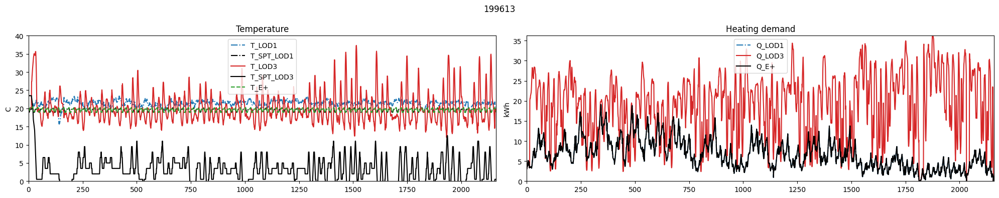

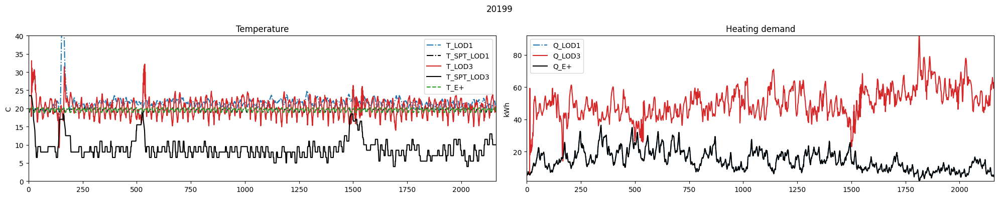

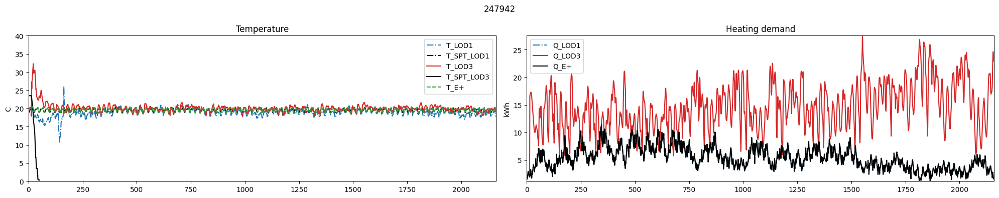

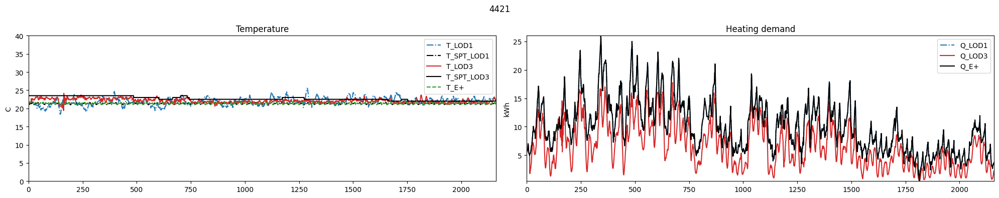

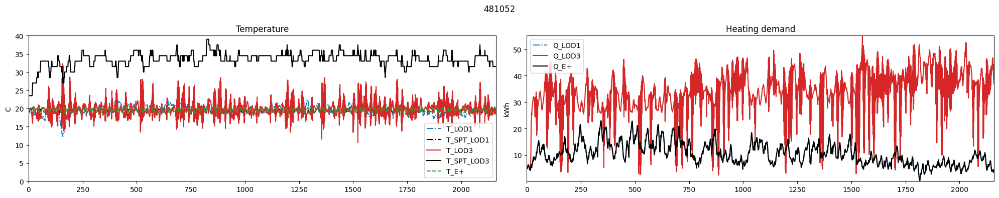

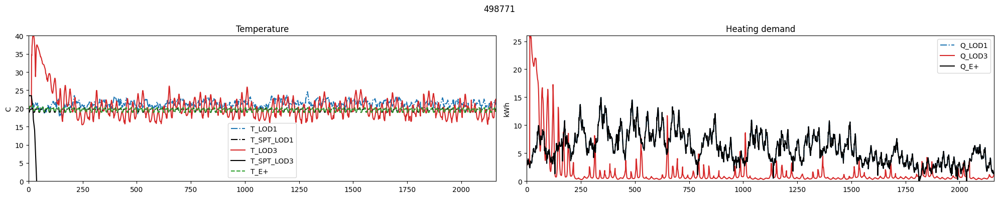

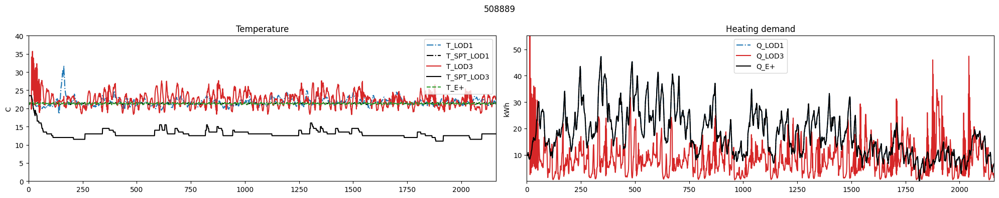

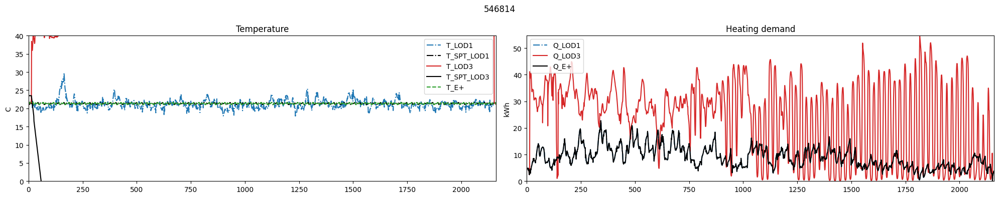

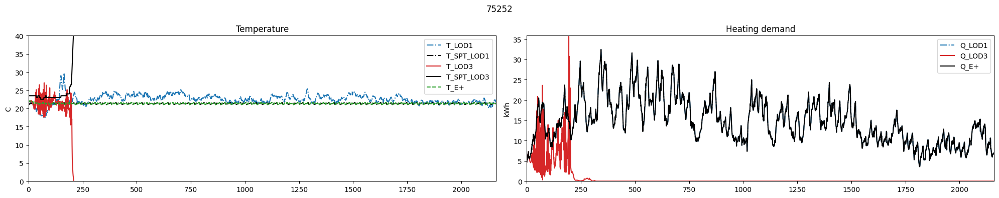

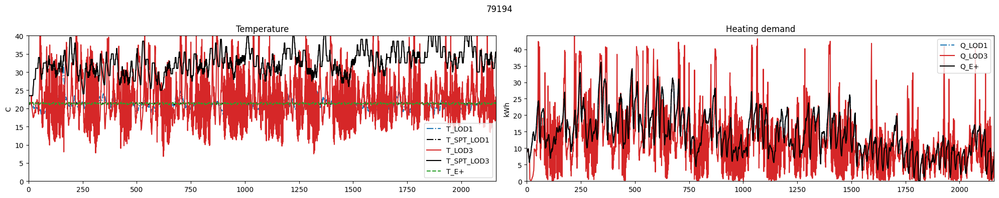

In [40]:
for b, bdata in data_23.groupby('bldg_name'):
    fig, axs = plt.subplots(1, 2, figsize=(20, 4))
    lod1data = bdata[bdata['lod']=='lod_1'].copy()
    lod3data = bdata[bdata['lod']=='lod_3'].copy()
    x = lod1data['time_step'].tolist()

    # temperature
    y1 = lod1data['indoor_dry_bulb_temperature'].tolist()
    y2 = lod1data['indoor_dry_bulb_temperature_set_point'].tolist()
    y3 = lod3data['indoor_dry_bulb_temperature'].tolist()
    y4 = lod3data['indoor_dry_bulb_temperature_set_point'].tolist()
    y5 = lod3data['indoor_dry_bulb_temperature_without_partial_load'].tolist()
    fig.axes[0].plot(x, y1, label='T_LOD1', color='tab:blue', linestyle='-.')
    fig.axes[0].plot(x, y2, label='T_SPT_LOD1', color='black', linestyle='-.')
    fig.axes[0].plot(x, y3, label='T_LOD3', color='tab:red', linestyle='-')
    fig.axes[0].plot(x, y4, label='T_SPT_LOD3', color='black', linestyle='-')
    fig.axes[0].plot(x, y5, label='T_E+', color='tab:green', linestyle='--')
    fig.axes[0].set_title('Temperature')
    fig.axes[0].set_ylim(0,40)
    fig.axes[0].set_ylabel('C')
    fig.axes[0].margins(0)
    fig.axes[0].legend()
    

    # demand
    y1 = lod1data['heating_demand'].tolist()
    y2 = lod3data['heating_demand'].tolist()
    y3 = lod3data['heating_demand_without_partial_load'].tolist()
    fig.axes[1].plot(x, y1, label='Q_LOD1', color='tab:blue', linestyle='-.')
    fig.axes[1].plot(x, y2, label='Q_LOD3', color='tab:red', linestyle='-')
    fig.axes[1].plot(x, y3, label='Q_E+', color='black', linestyle='-')
    fig.axes[1].set_title('Heating demand')
    fig.axes[1].set_ylabel('kWh')
    fig.axes[1].margins(0)
    fig.axes[1].legend()

    fig.suptitle(b)
    plt.tight_layout()
    plt.show()

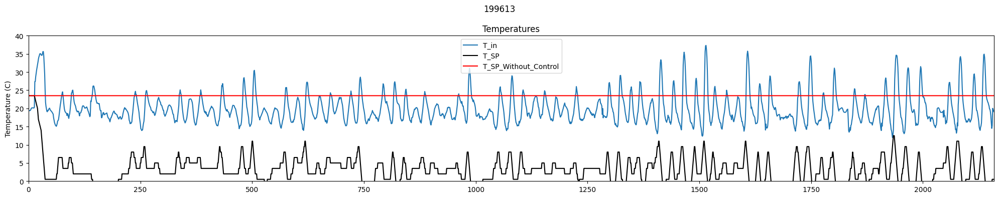

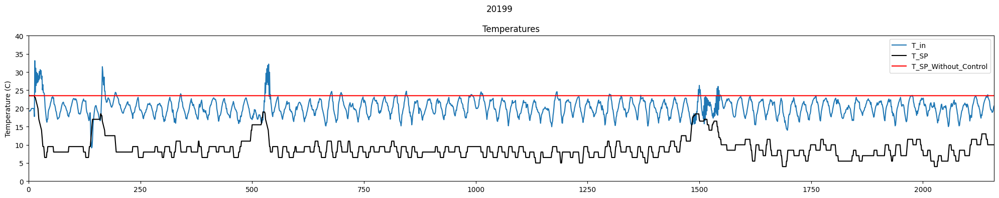

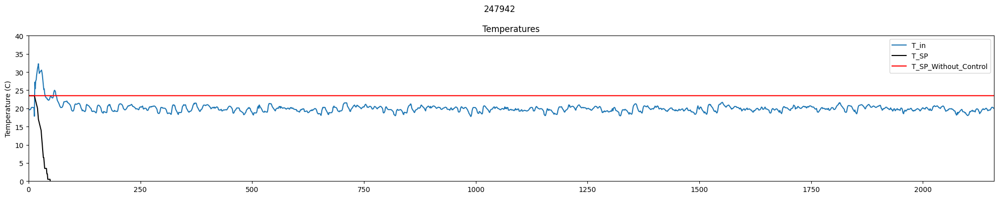

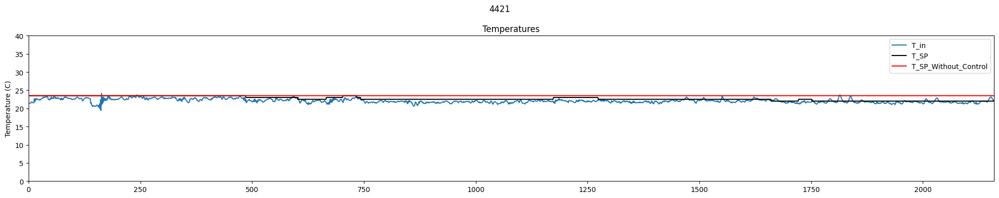

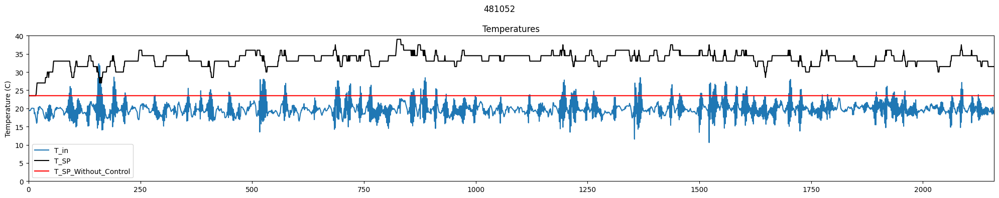

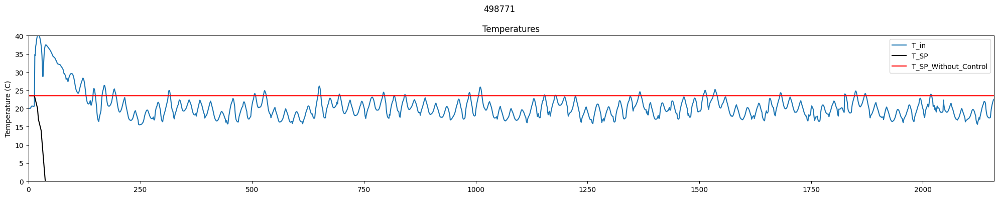

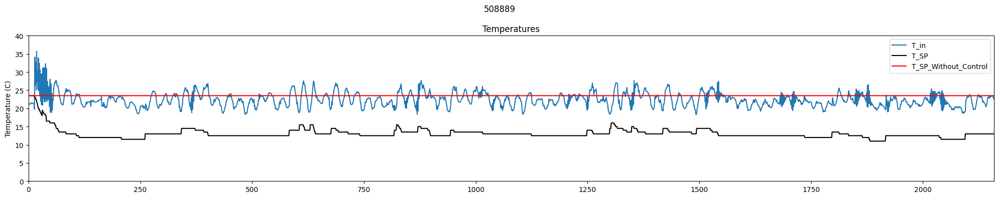

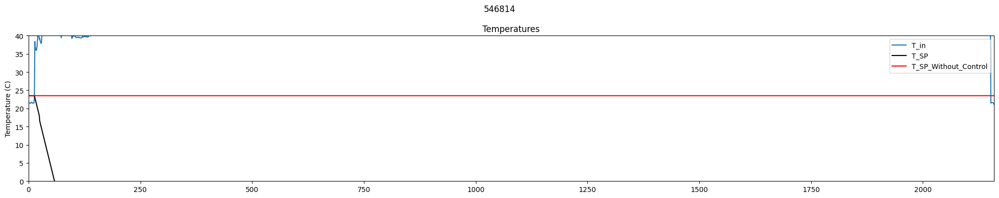

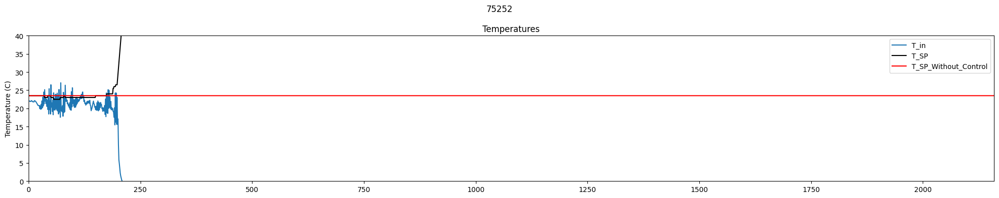

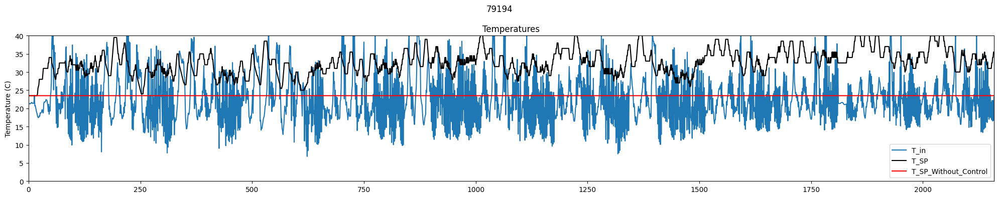

In [41]:
for b, bdata in data_23.groupby('bldg_name'):
    fig, axs = plt.subplots(1, figsize=(20, 4))
    lod3data = bdata[bdata['lod']=='lod_3'].copy()
    x = lod3data['time_step'].tolist()

    # temperature
    y1 = lod3data['indoor_dry_bulb_temperature'].tolist()
    y2 = lod3data['indoor_dry_bulb_temperature_set_point'].tolist()
    y3 = lod3data['indoor_dry_bulb_temperature_set_point_without_control'].tolist()
    fig.axes[0].plot(x, y1, label='T_in', color='tab:blue') #linestyle='-.')
    fig.axes[0].plot(x, y2, label='T_SP', color='black') #linestyle='-.')
    fig.axes[0].plot(x, y3, label='T_SP_Without_Control', color='red') #linestyle='-.')


    fig.axes[0].set_title('Temperatures')
    fig.axes[0].set_ylim(0,40)
    fig.axes[0].set_ylabel('Temperature (C)')
    fig.axes[0].margins(0)
    fig.axes[0].legend()

    fig.suptitle(b)
    plt.tight_layout()
    plt.show()

### TEST WITH REGULAR SP SCHEDULE: LOD 3 12.11

In [50]:
data_reg = pd.concat(
    [DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_1-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_2-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_3-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_4-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_5-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_6-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_7-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_8-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_9-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_10-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_1-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_2-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_3-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_4-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_5-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_6-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_7-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_8-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_9-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_10-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_1-citylearn-rbc-norbc-centralized-noreward-building_all-final-2022', 'time_series')],
    ignore_index=True)

unique_values_in_order_reg = data_reg['bldg_name'].unique().tolist()

buildings_reg = unique_values_in_order_reg
data_reg = data_reg[data_reg['bldg_name'].isin(buildings_reg)].copy()
data_reg['lod'] = data_reg['id'].str.split('-', expand=True)[0]

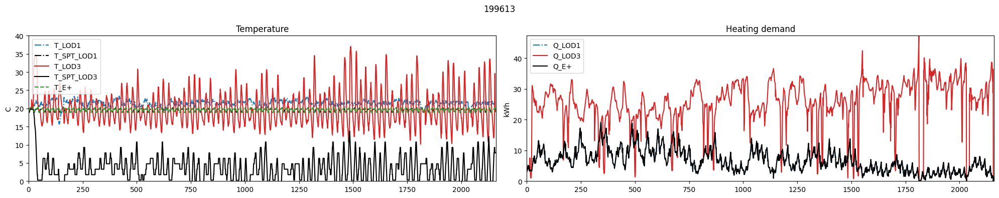

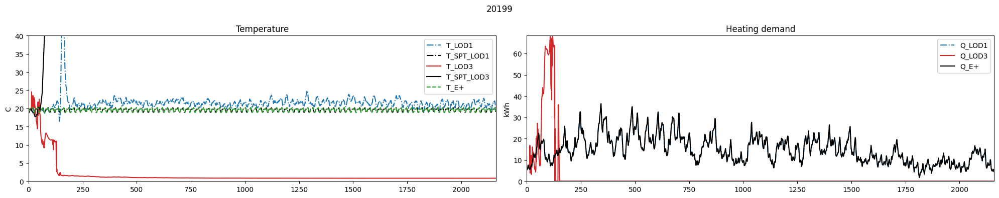

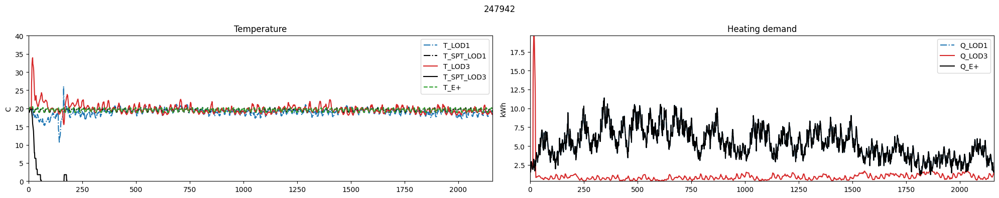

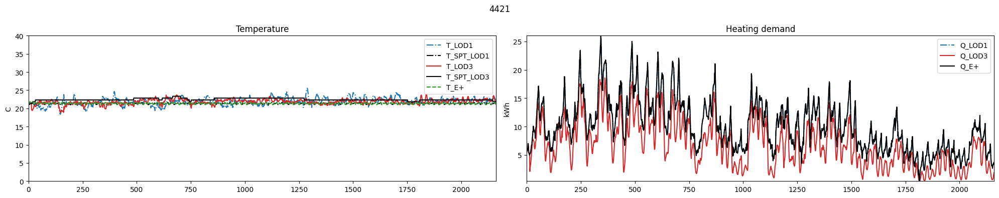

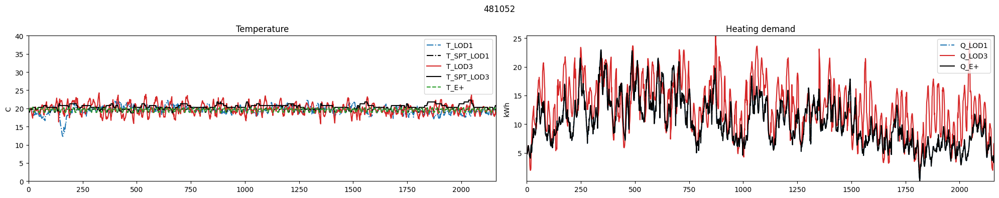

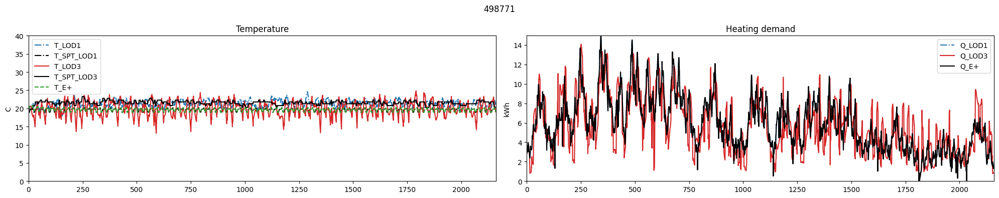

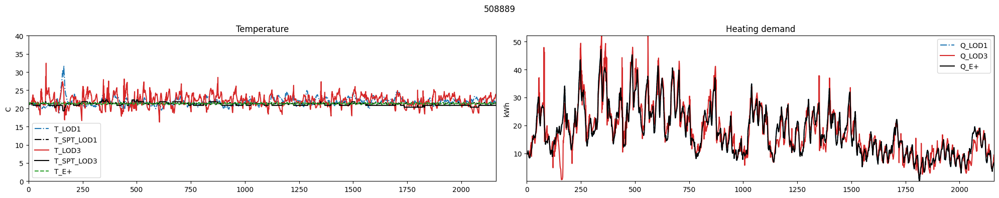

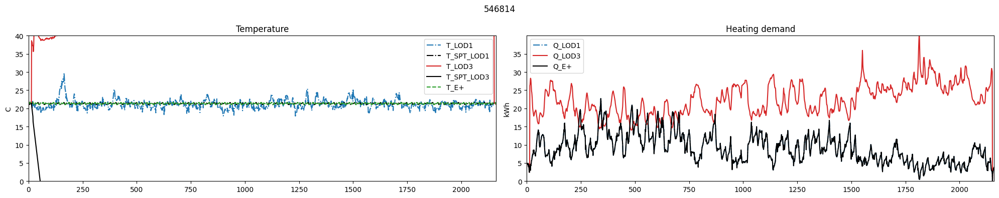

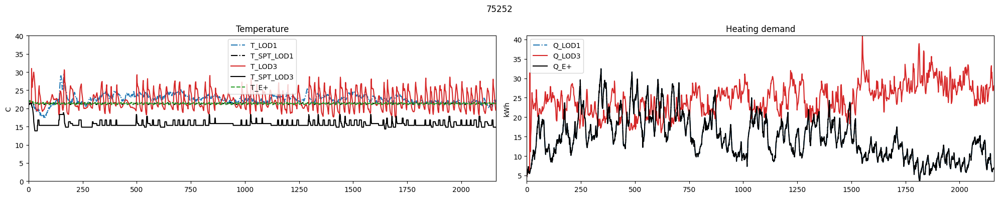

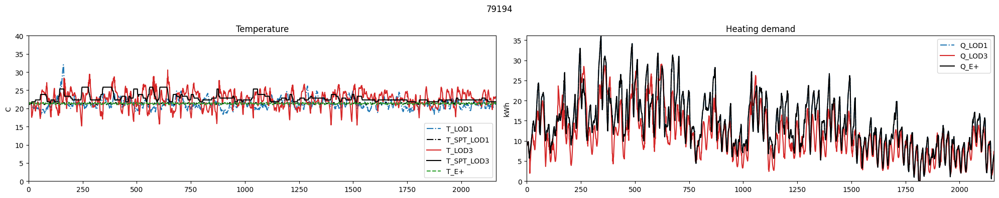

In [51]:
for b, bdata in data_reg.groupby('bldg_name'):
    fig, axs = plt.subplots(1, 2, figsize=(20, 4))
    lod1data = bdata[bdata['lod']=='lod_1'].copy()
    lod3data = bdata[bdata['lod']=='lod_3'].copy()
    x = lod1data['time_step'].tolist()

    # temperature
    y1 = lod1data['indoor_dry_bulb_temperature'].tolist()
    y2 = lod1data['indoor_dry_bulb_temperature_set_point'].tolist()
    y3 = lod3data['indoor_dry_bulb_temperature'].tolist()
    y4 = lod3data['indoor_dry_bulb_temperature_set_point'].tolist()
    y5 = lod3data['indoor_dry_bulb_temperature_without_partial_load'].tolist()
    fig.axes[0].plot(x, y1, label='T_LOD1', color='tab:blue', linestyle='-.')
    fig.axes[0].plot(x, y2, label='T_SPT_LOD1', color='black', linestyle='-.')
    fig.axes[0].plot(x, y3, label='T_LOD3', color='tab:red', linestyle='-')
    fig.axes[0].plot(x, y4, label='T_SPT_LOD3', color='black', linestyle='-')
    fig.axes[0].plot(x, y5, label='T_E+', color='tab:green', linestyle='--')
    fig.axes[0].set_title('Temperature')
    fig.axes[0].set_ylim(0,40)
    fig.axes[0].set_ylabel('C')
    fig.axes[0].margins(0)
    fig.axes[0].legend()
    

    # demand
    y1 = lod1data['heating_demand'].tolist()
    y2 = lod3data['heating_demand'].tolist()
    y3 = lod3data['heating_demand_without_partial_load'].tolist()
    fig.axes[1].plot(x, y1, label='Q_LOD1', color='tab:blue', linestyle='-.')
    fig.axes[1].plot(x, y2, label='Q_LOD3', color='tab:red', linestyle='-')
    fig.axes[1].plot(x, y3, label='Q_E+', color='black', linestyle='-')
    fig.axes[1].set_title('Heating demand')
    fig.axes[1].set_ylabel('kWh')
    fig.axes[1].margins(0)
    fig.axes[1].legend()

    fig.suptitle(b)
    plt.tight_layout()
    plt.show()

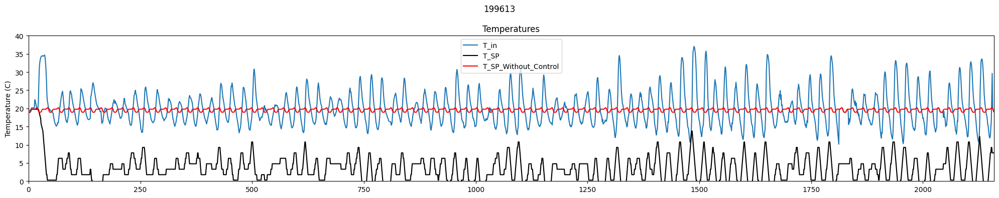

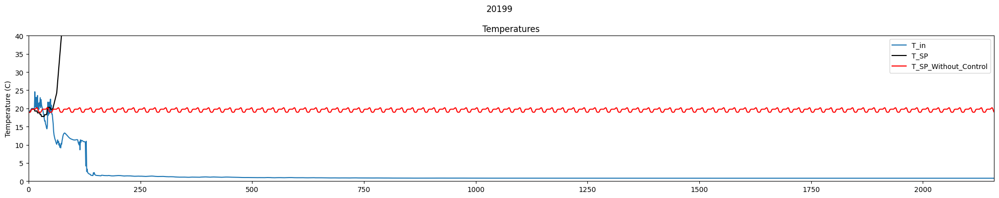

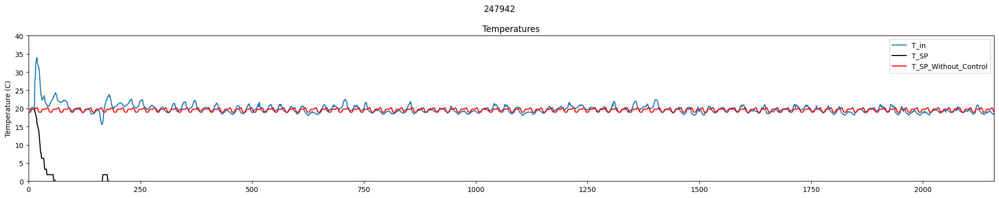

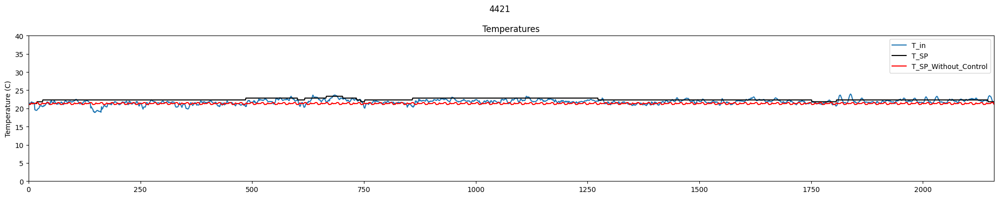

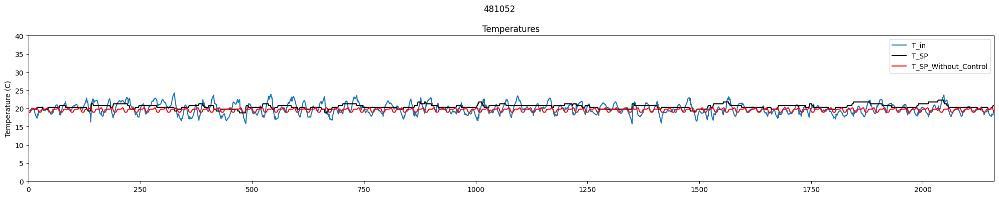

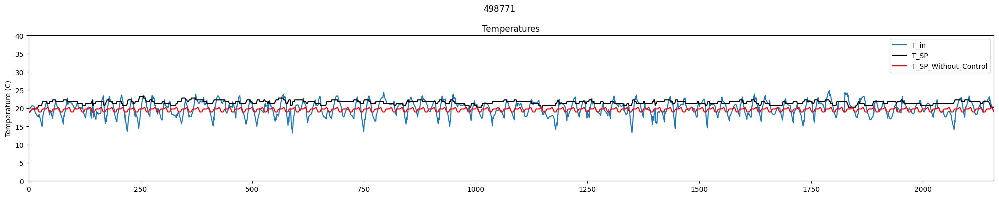

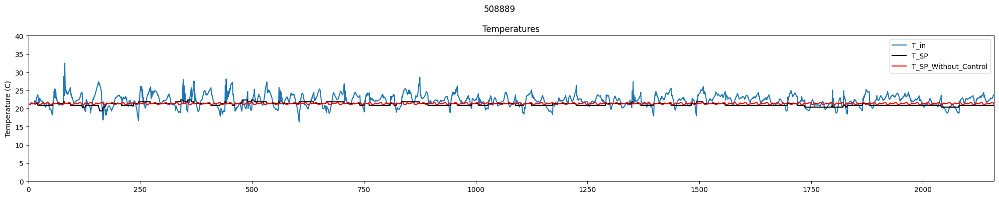

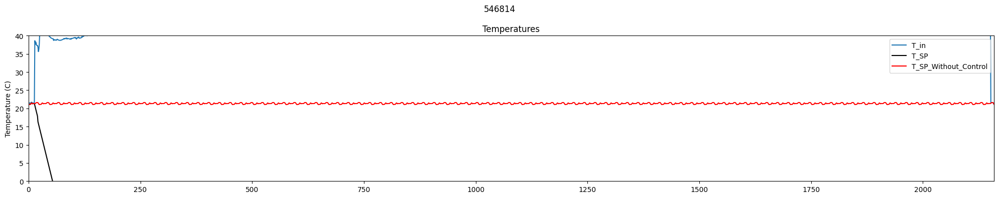

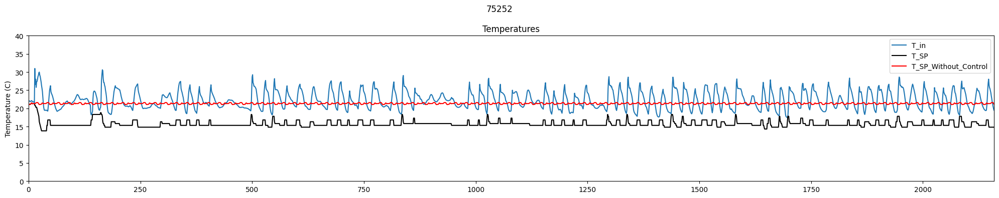

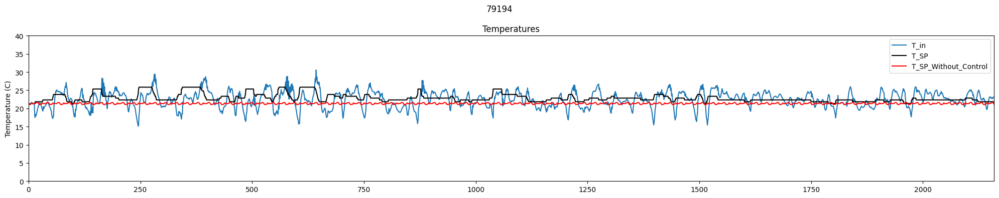

In [52]:
for b, bdata in data_reg.groupby('bldg_name'):
    fig, axs = plt.subplots(1, figsize=(20, 4))
    lod3data = bdata[bdata['lod']=='lod_3'].copy()
    x = lod3data['time_step'].tolist()

    # temperature
    y1 = lod3data['indoor_dry_bulb_temperature'].tolist()
    y2 = lod3data['indoor_dry_bulb_temperature_set_point'].tolist()
    y3 = lod3data['indoor_dry_bulb_temperature_set_point_without_control'].tolist()
    fig.axes[0].plot(x, y1, label='T_in', color='tab:blue') #linestyle='-.')
    fig.axes[0].plot(x, y2, label='T_SP', color='black') #linestyle='-.')
    fig.axes[0].plot(x, y3, label='T_SP_Without_Control', color='red') #linestyle='-.')


    fig.axes[0].set_title('Temperatures')
    fig.axes[0].set_ylim(0,40)
    fig.axes[0].set_ylabel('Temperature (C)')
    fig.axes[0].margins(0)
    fig.axes[0].legend()

    fig.suptitle(b)
    plt.tight_layout()
    plt.show()

### TEST WITH REGULAR SP SCHEDULE: LOD 3 12.21 NEW LSTMS

In [2]:
data_reg = pd.concat(
    [DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_1-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_2-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_3-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_4-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_5-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_6-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_7-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_8-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_9-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_10-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_1-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_2-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_3-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_4-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_5-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_6-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_7-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_8-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_9-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_10-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_1-citylearn-rbc-norbc-centralized-noreward-building_all-final-2022', 'time_series')],
    ignore_index=True)

unique_values_in_order_reg = data_reg['bldg_name'].unique().tolist()

buildings_reg = unique_values_in_order_reg
data_reg = data_reg[data_reg['bldg_name'].isin(buildings_reg)].copy()
data_reg['lod'] = data_reg['id'].str.split('-', expand=True)[0]

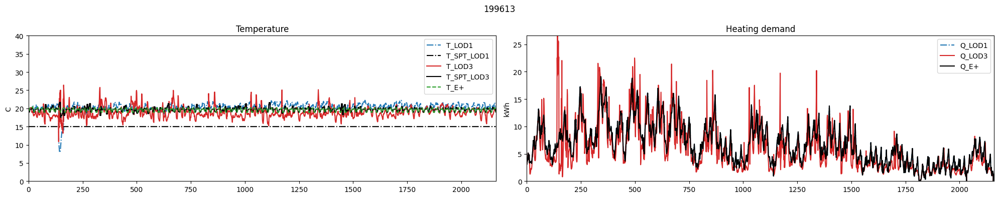

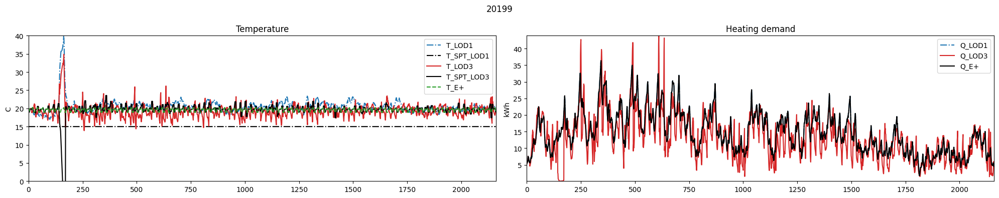

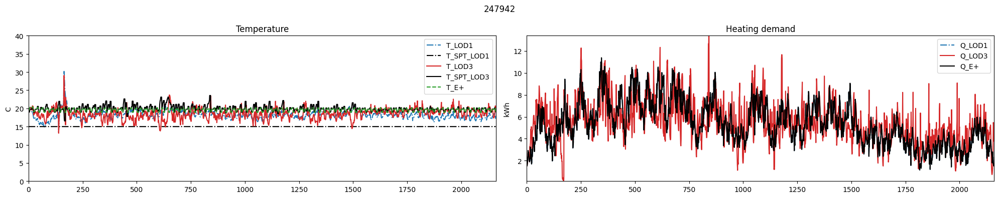

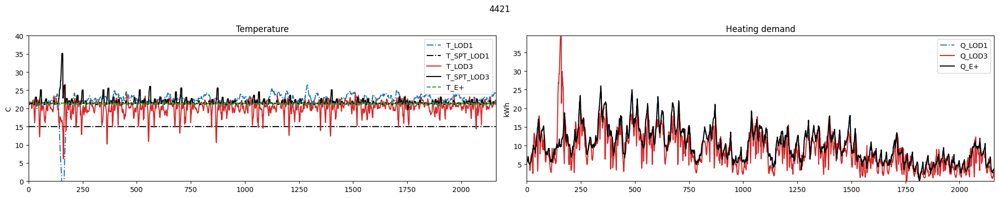

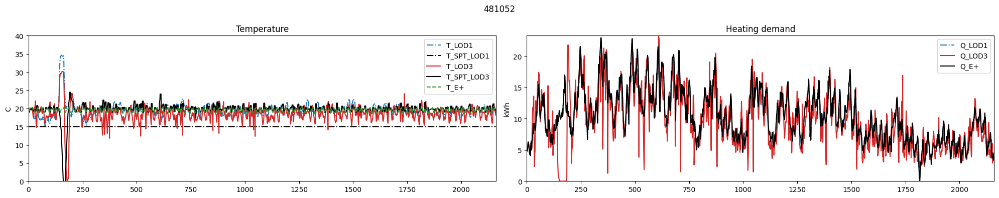

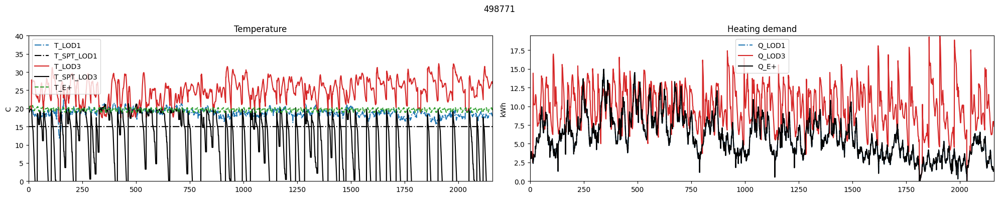

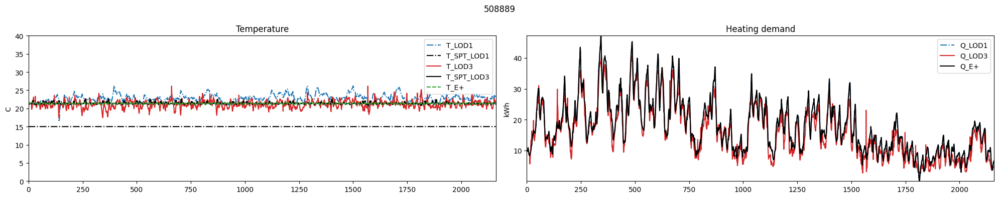

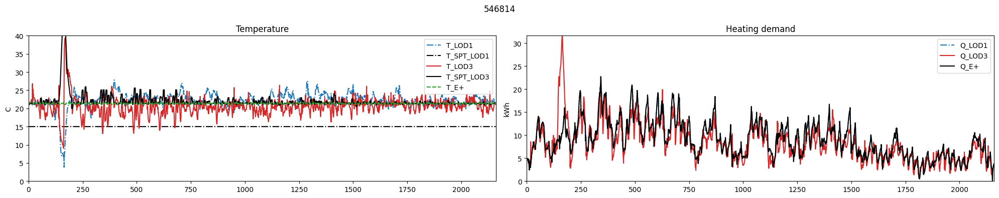

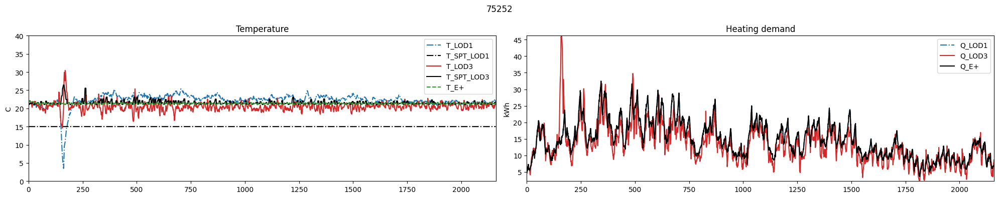

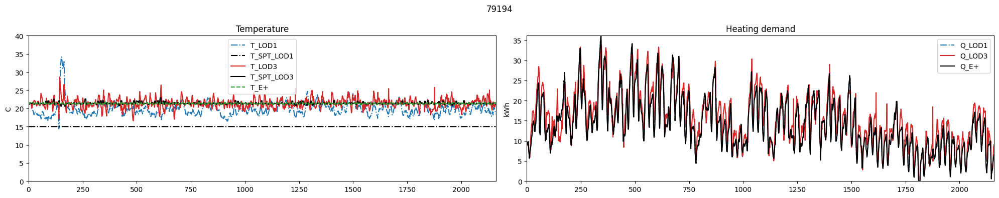

In [3]:
for b, bdata in data_reg.groupby('bldg_name'):
    fig, axs = plt.subplots(1, 2, figsize=(20, 4))
    lod1data = bdata[bdata['lod']=='lod_1'].copy()
    lod3data = bdata[bdata['lod']=='lod_3'].copy()
    x = lod1data['time_step'].tolist()

    # temperature
    y1 = lod1data['indoor_dry_bulb_temperature'].tolist()
    y2 = lod1data['indoor_dry_bulb_temperature_set_point'].tolist()
    y3 = lod3data['indoor_dry_bulb_temperature'].tolist()
    y4 = lod3data['indoor_dry_bulb_temperature_set_point'].tolist()
    y5 = lod3data['indoor_dry_bulb_temperature_without_partial_load'].tolist()
    fig.axes[0].plot(x, y1, label='T_LOD1', color='tab:blue', linestyle='-.')
    fig.axes[0].plot(x, y2, label='T_SPT_LOD1', color='black', linestyle='-.')
    fig.axes[0].plot(x, y3, label='T_LOD3', color='tab:red', linestyle='-')
    fig.axes[0].plot(x, y4, label='T_SPT_LOD3', color='black', linestyle='-')
    fig.axes[0].plot(x, y5, label='T_E+', color='tab:green', linestyle='--')
    fig.axes[0].set_title('Temperature')
    fig.axes[0].set_ylim(0,40)
    fig.axes[0].set_ylabel('C')
    fig.axes[0].margins(0)
    fig.axes[0].legend()
    

    # demand
    y1 = lod1data['heating_demand'].tolist()
    y2 = lod3data['heating_demand'].tolist()
    y3 = lod3data['heating_demand_without_partial_load'].tolist()
    fig.axes[1].plot(x, y1, label='Q_LOD1', color='tab:blue', linestyle='-.')
    fig.axes[1].plot(x, y2, label='Q_LOD3', color='tab:red', linestyle='-')
    fig.axes[1].plot(x, y3, label='Q_E+', color='black', linestyle='-')
    fig.axes[1].set_title('Heating demand')
    fig.axes[1].set_ylabel('kWh')
    fig.axes[1].margins(0)
    fig.axes[1].legend()

    fig.suptitle(b)
    plt.tight_layout()
    plt.show()

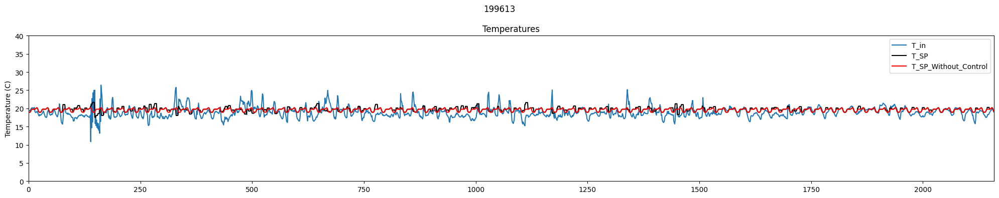

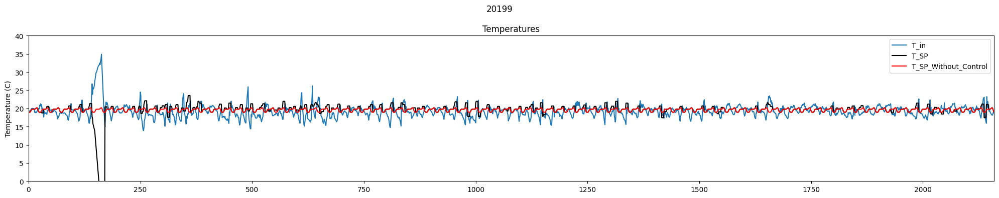

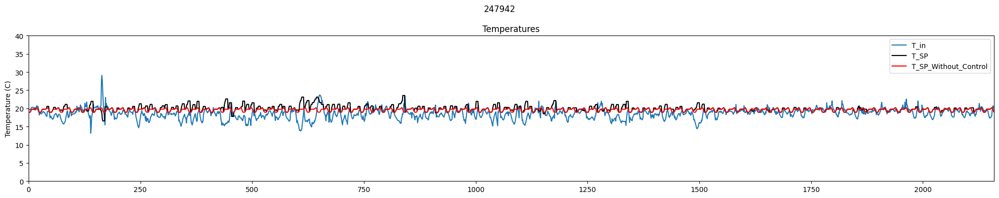

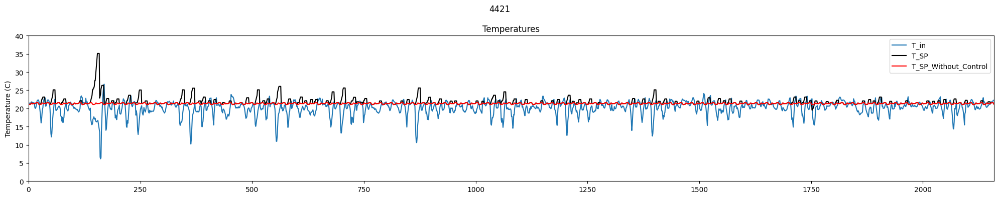

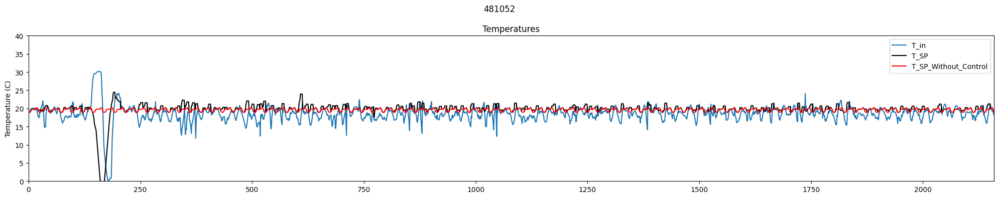

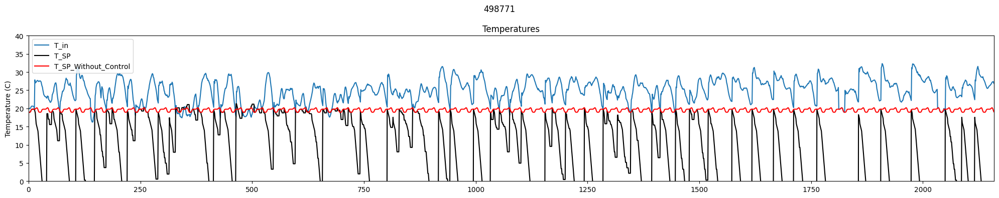

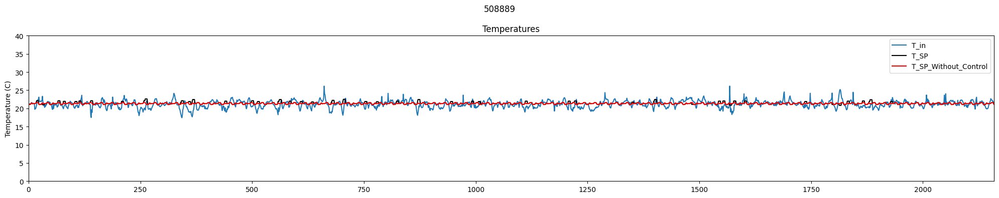

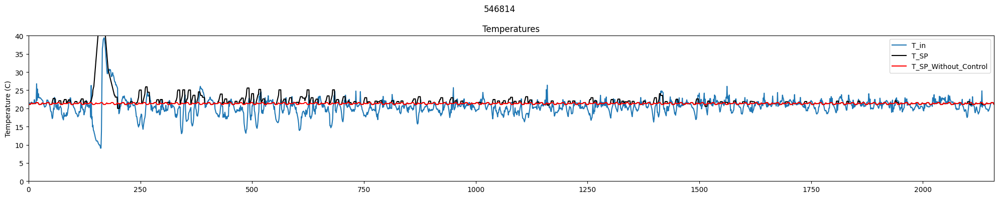

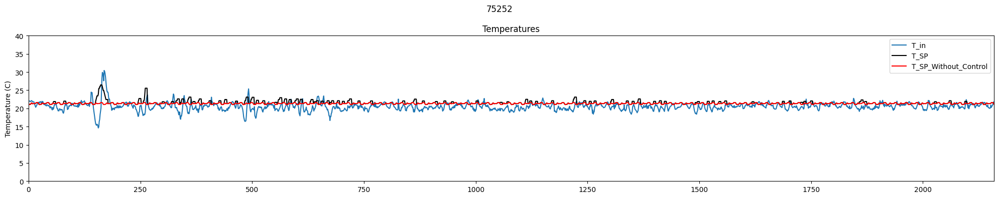

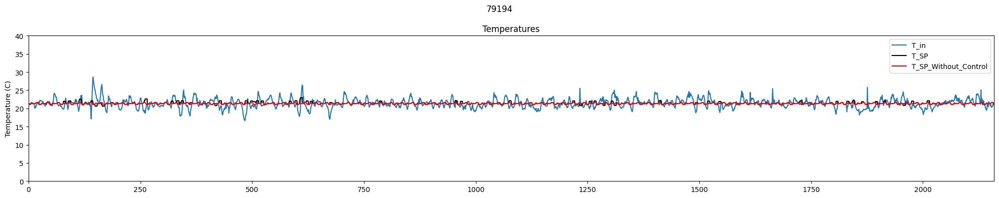

In [4]:
for b, bdata in data_reg.groupby('bldg_name'):
    fig, axs = plt.subplots(1, figsize=(20, 4))
    lod3data = bdata[bdata['lod']=='lod_3'].copy()
    x = lod3data['time_step'].tolist()

    # temperature
    y1 = lod3data['indoor_dry_bulb_temperature'].tolist()
    y2 = lod3data['indoor_dry_bulb_temperature_set_point'].tolist()
    y3 = lod3data['indoor_dry_bulb_temperature_set_point_without_control'].tolist()
    fig.axes[0].plot(x, y1, label='T_in', color='tab:blue') #linestyle='-.')
    fig.axes[0].plot(x, y2, label='T_SP', color='black') #linestyle='-.')
    fig.axes[0].plot(x, y3, label='T_SP_Without_Control', color='red') #linestyle='-.')


    fig.axes[0].set_title('Temperatures')
    fig.axes[0].set_ylim(0,40)
    fig.axes[0].set_ylabel('Temperature (C)')
    fig.axes[0].margins(0)
    fig.axes[0].legend()

    fig.suptitle(b)
    plt.tight_layout()
    plt.show()